<a href="https://colab.research.google.com/github/shiv092022/Projects/blob/master/Magdumproj.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
!git clone https://github.com/NVlabs/stylegan3.git
!pip install ninja

Cloning into 'stylegan3'...
remote: Enumerating objects: 212, done.
remote: Counting objects: 100% (5/5), done.
remote: Compressing objects: 100% (5/5), done.
remote: Total 212 (delta 0), reused 1 (delta 0), pack-reused 207
Receiving objects: 100% (212/212), 4.16 MiB | 25.84 MiB/s, done.
Resolving deltas: 100% (101/101), done.
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 307.2/307.2 kB 7.2 MB/s eta 0:00:00


In [ ]:
import sys
sys.path.insert(0, "/content/stylegan3")
import pickle
import os
import numpy as np
import pandas as pd
import PIL.Image
from IPython.display import Image
import matplotlib.pyplot as plt
import IPython.display
import torch
import dnnlib
import legacy

In [ ]:
def seed2vec(G, seed):
  return np.random.RandomState(seed).randn(1, G.z_dim)

def display_image(image):
  plt.axis('off')
  plt.imshow(image)
  plt.show()
def get_label(G, device, class_idx):
  label = torch.zeros([1, G.c_dim], device=device)
  if G.c_dim != 0:
      if class_idx is None:
          ctx.fail('Must specify class label with --class when using a conditional network')
      label[:, class_idx] = 1
  else:
      if class_idx is not None:
          print ('warn: --class=lbl ignored when running on an unconditional network')
  return label
def generate_image(device, G, z, truncation_psi=1.0,noise_mode='const', class_idx=None):
  z = torch.from_numpy(z).to(device)
  label = get_label(G, device, class_idx)
  img = G(z, label, truncation_psi=truncation_psi,noise_mode=noise_mode)
  img = (img.permute(0, 2, 3, 1) * 127.5 + 128).clamp(0, 255).to(torch.uint8)
  return PIL.Image.fromarray(img[0].cpu().numpy(), 'RGB')

In [ ]:
URL = "https://api.ngc.nvidia.com/v2/models/nvidia/research/stylegan3/versions/1/files/stylegan3-r-ffhq-1024x1024.pkl"

print('Loading networks from "%s"...' % URL)
device = torch.device('cuda')
with dnnlib.util.open_url(URL) as fp:
    G = legacy.load_network_pkl(fp)['G_ema'].requires_grad_(False).to(device)

Loading networks from "https://api.ngc.nvidia.com/v2/models/nvidia/research/stylegan3/versions/1/files/stylegan3-r-ffhq-1024x1024.pkl"...


In [ ]:
os.mkdir('input_images')
os.mkdir('different-looks-of-selectedimage')
os.mkdir('beard-transformation_images')
os.mkdir('age-transformation_images')

FileExistsError: [Errno 17] File exists: 'input_images'

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


Seed 4010


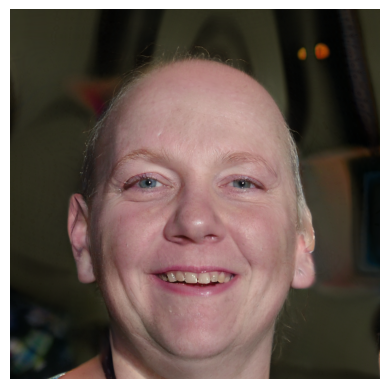

Seed 4011


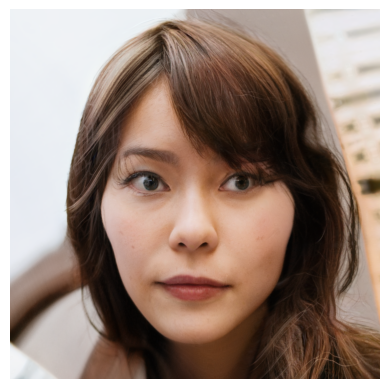

Seed 4012


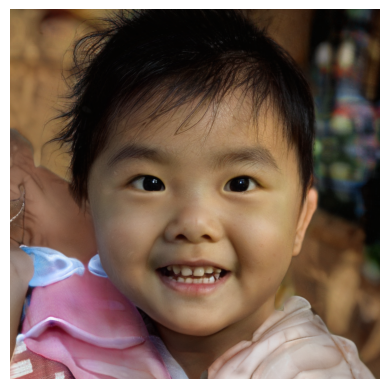

Seed 4013


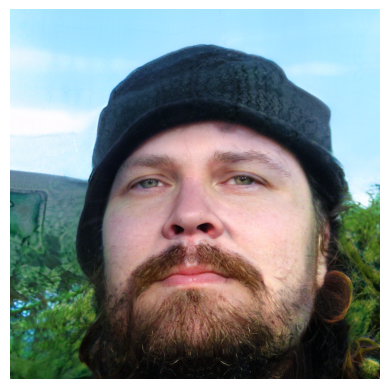

Seed 4014


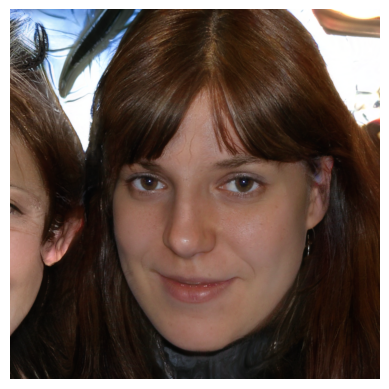

Seed 4015


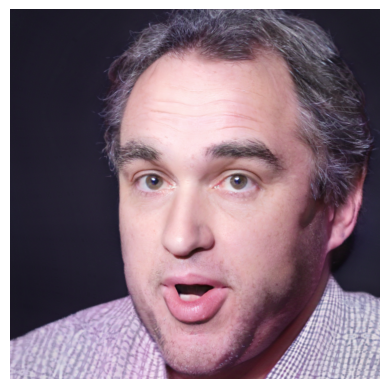

Seed 4016


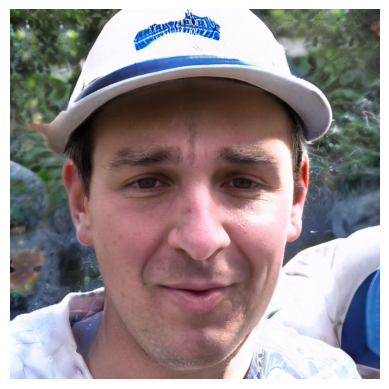

Seed 4017


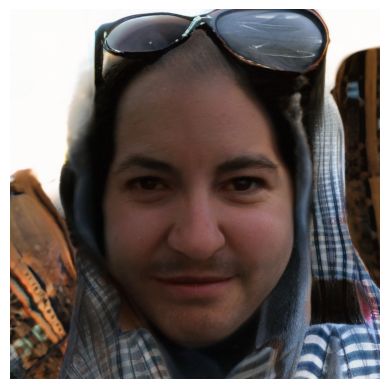

Seed 4018


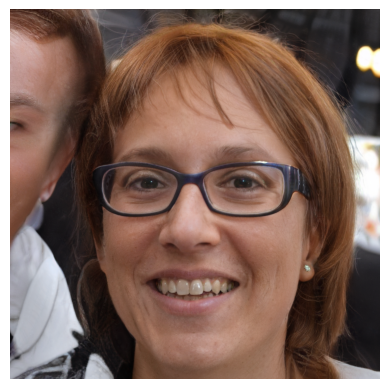

Seed 4019


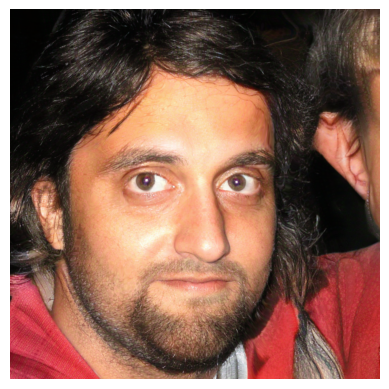

Seed 4020


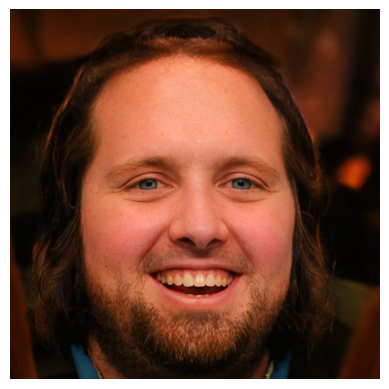

Seed 4021


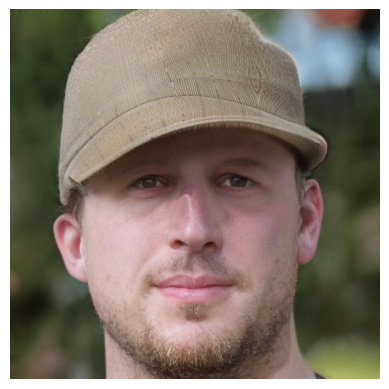

Seed 4022


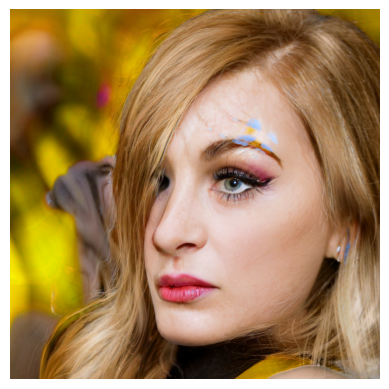

Seed 4023


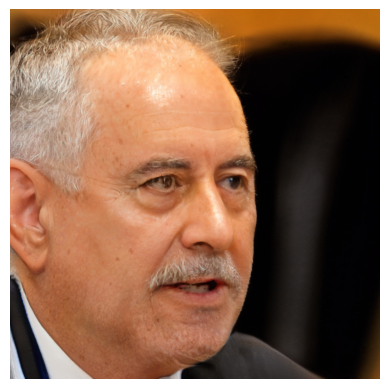

Seed 4024


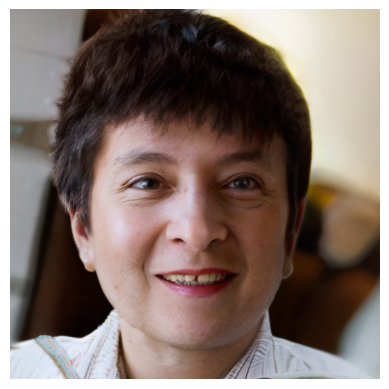

Seed 4025


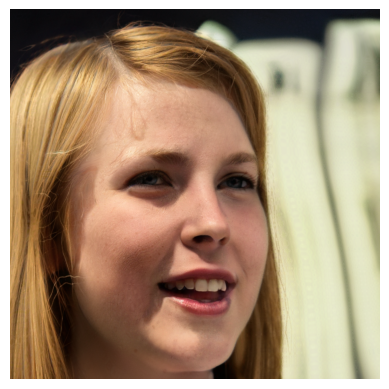

Seed 4026


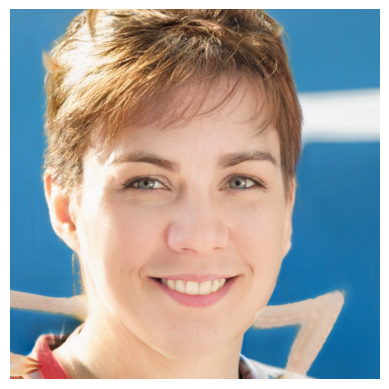

Seed 4027


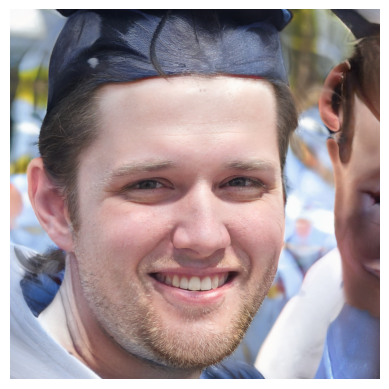

Seed 4028


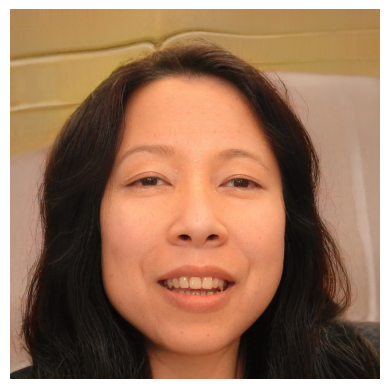

Seed 4029


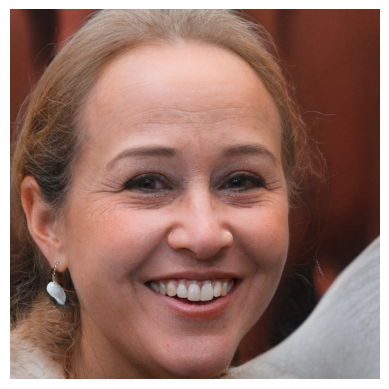

In [ ]:
SEED_FROM = 4010
SEED_TO = 4030
folder_name = 'input_images'
for i in range(SEED_FROM, SEED_TO):
  print(f"Seed {i}")
  z = seed2vec(G, i)
  img = generate_image(device, G, z)
  display_image(img)
  img.save(f'{folder_name}/image_{i}.jpg')
  img.save(f'/content/drive/MyDrive/input_images/image_{i}.jpg')

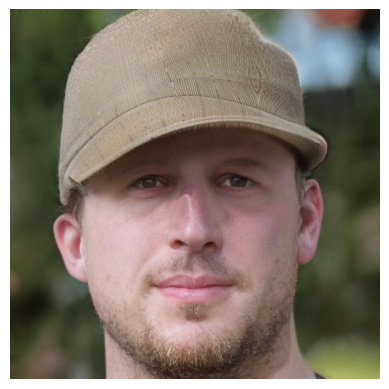

In [ ]:
START_SEED = 4021
current = seed2vec(G, START_SEED)
img = generate_image(device, G, current)
SCALE = 0.5
display_image(img)
current = seed2vec(G, START_SEED)

Direction 0


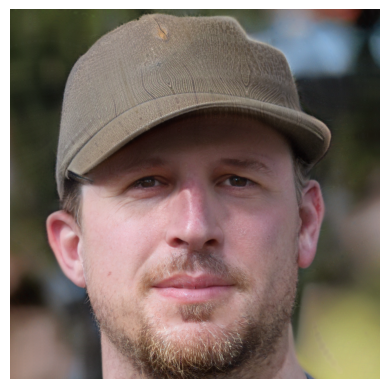

Direction 1


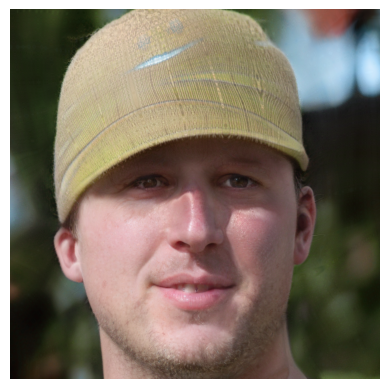

Direction 2


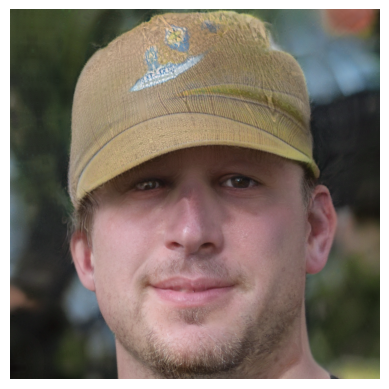

Direction 3


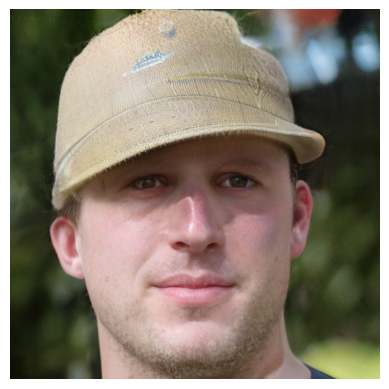

Direction 4


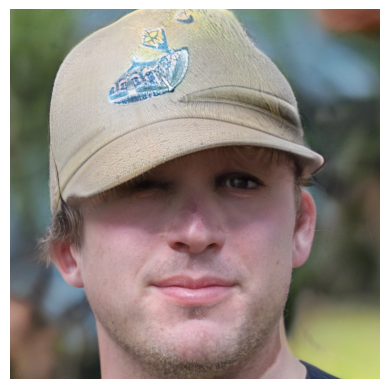

Direction 5


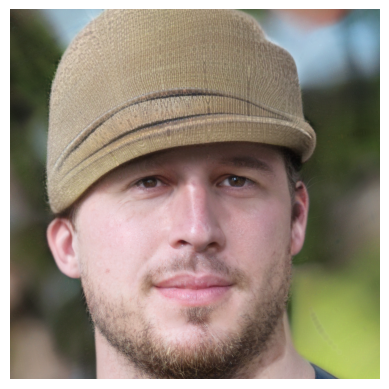

Direction 6


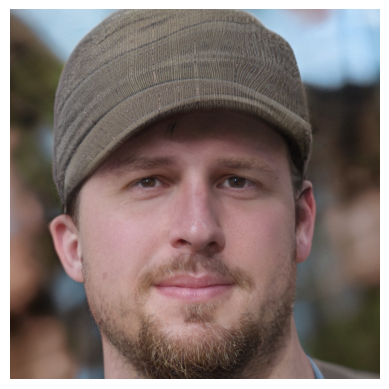

Direction 7


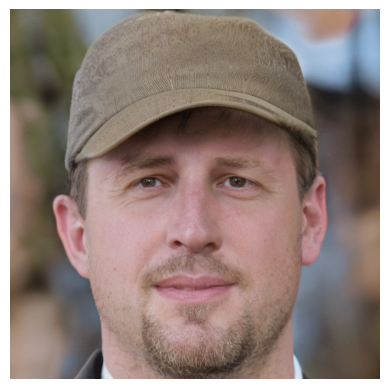

Direction 8


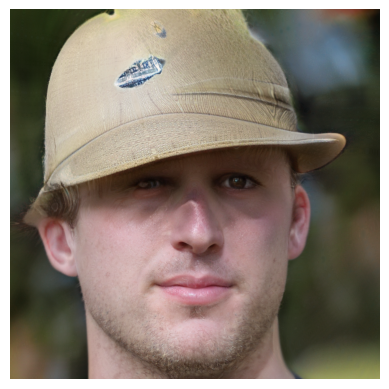

Direction 9


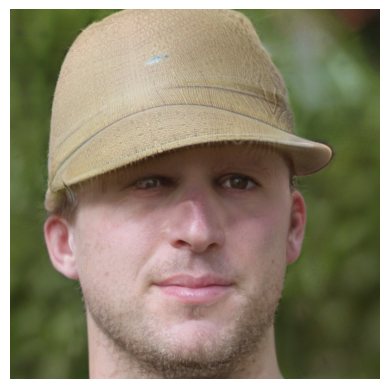

Direction 10


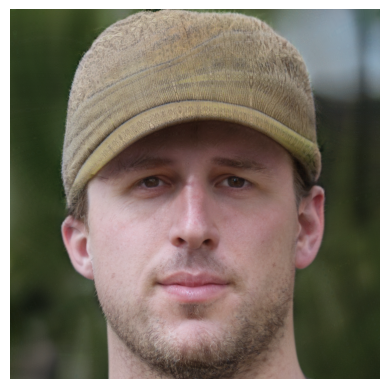

Direction 11


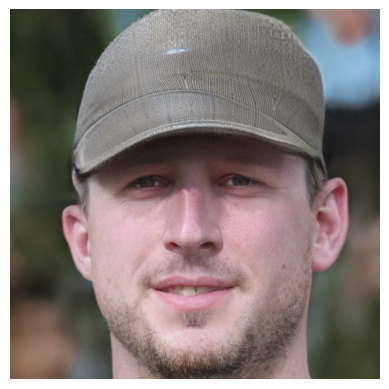

Direction 12


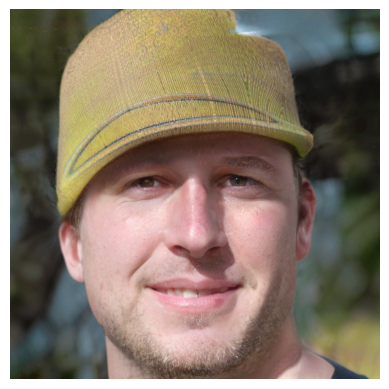

Direction 13


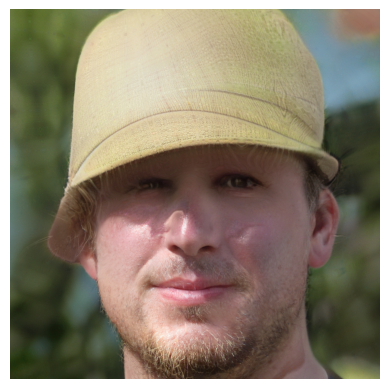

Direction 14


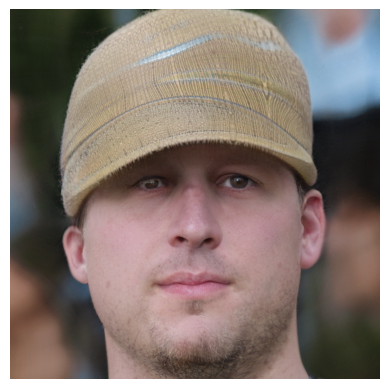

Direction 15


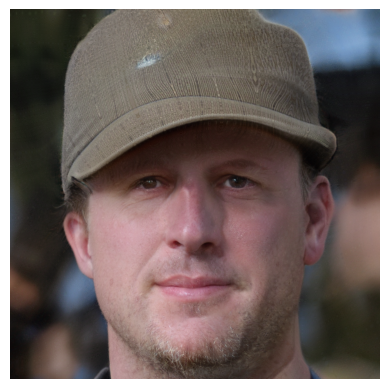

Direction 16


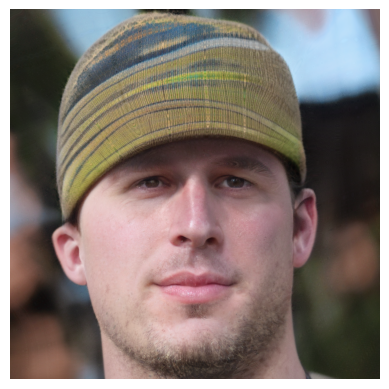

Direction 17


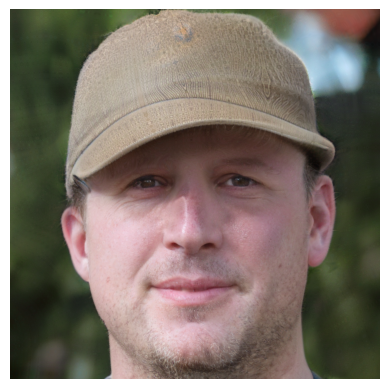

Direction 18


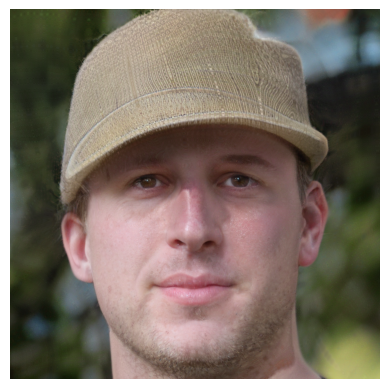

Direction 19


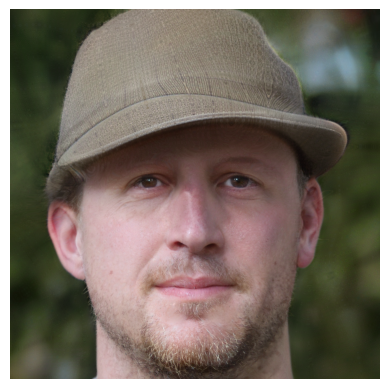

Direction 20


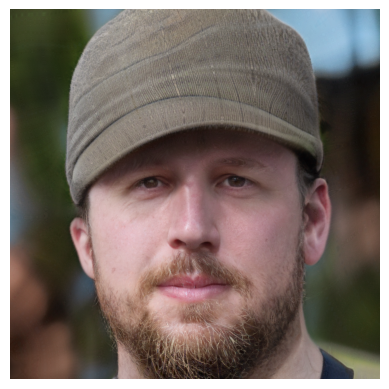

Direction 21


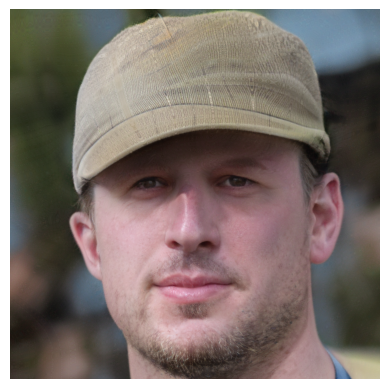

Direction 22


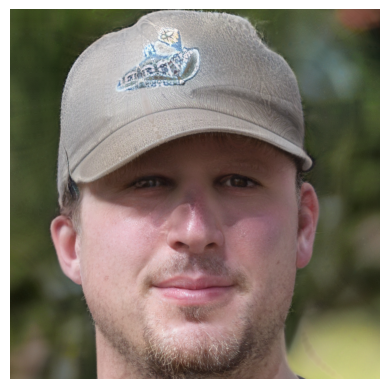

Direction 23


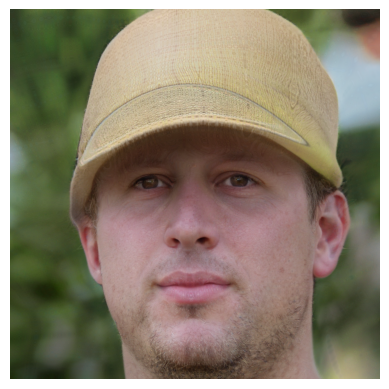

Direction 24


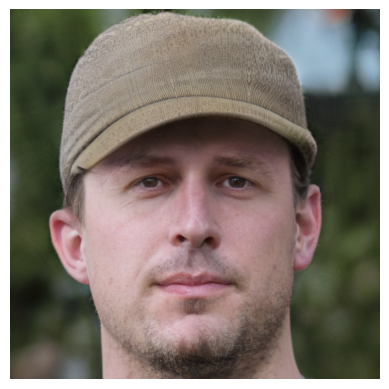

In [ ]:
np.random.seed(42)
EXPLORE_SIZE = 25
explore = []
for i in range(EXPLORE_SIZE):
  explore.append( np.random.rand(1, 512) - 0.5 )

MOVE_DIRECTION = -1
SCALE = 0.5
folder_name = 'different-looks-of-selectedimage'
if MOVE_DIRECTION >=0:
  current = current + explore[MOVE_DIRECTION]
for i, mv in enumerate(explore):
  print(f"Direction {i}")
  z = current + mv
  img = generate_image(device, G, z)
  display_image(img)
  img.save(f'{folder_name}/image_{i}.jpg')
  img.save(f'/content/drive/MyDrive/different-looks-of-selectedimage/image_{i}.jpg')

Direction 0


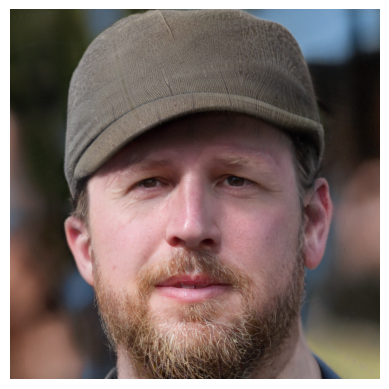

Direction 1


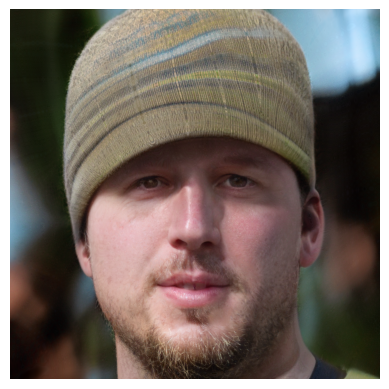

Direction 2


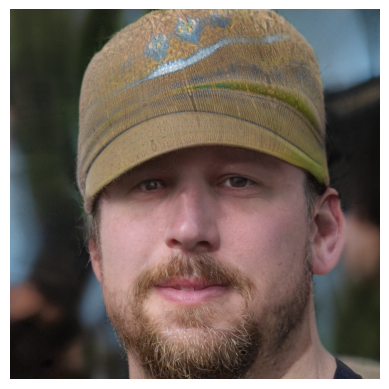

Direction 3


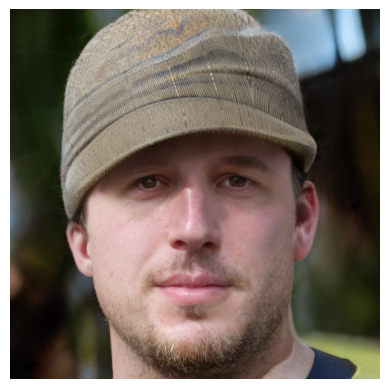

Direction 4


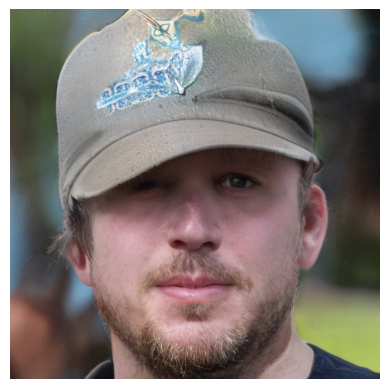

Direction 5


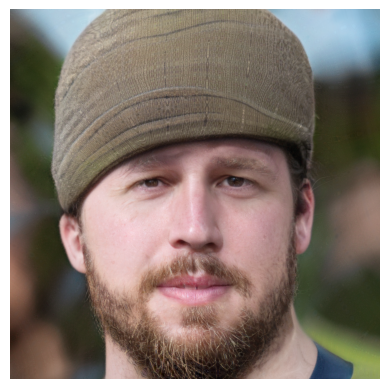

Direction 6


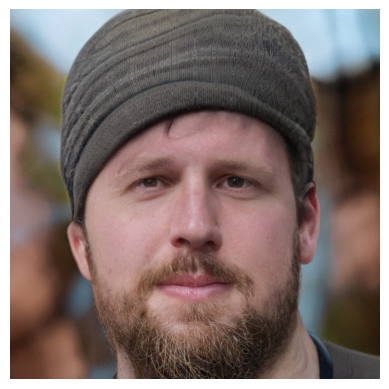

Direction 7


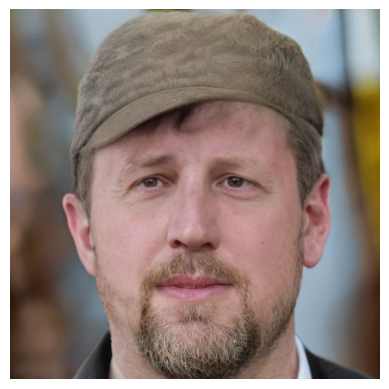

Direction 8


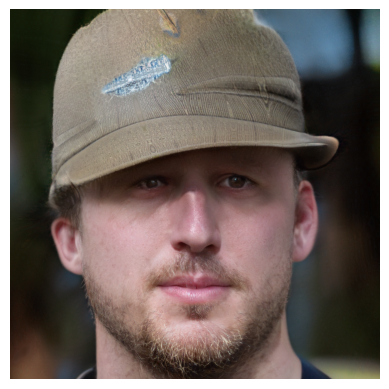

Direction 9


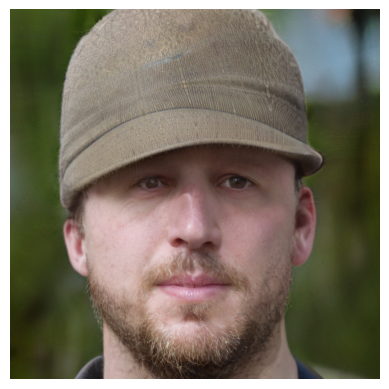

Direction 10


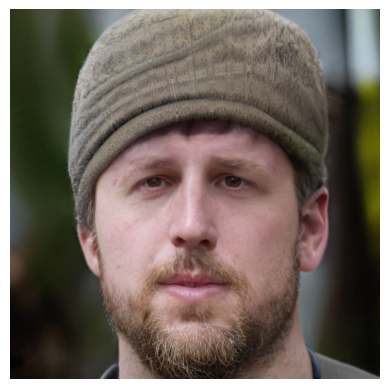

Direction 11


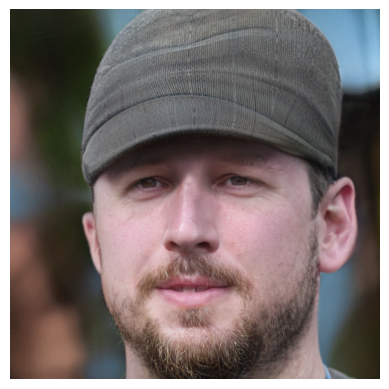

Direction 12


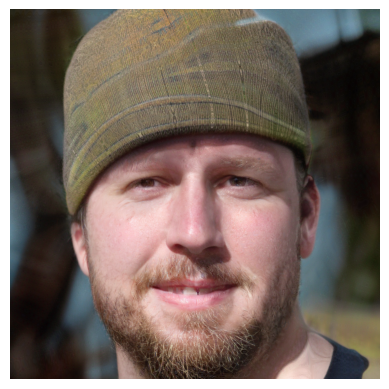

Direction 13


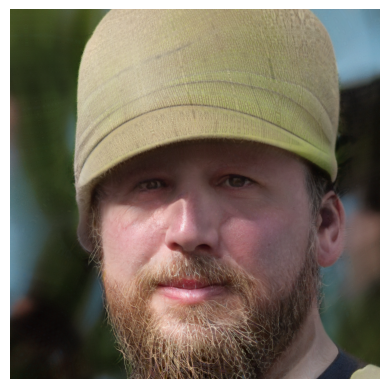

Direction 14


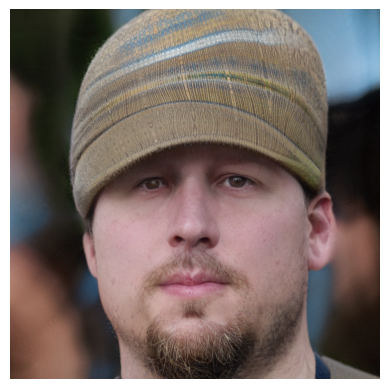

Direction 15


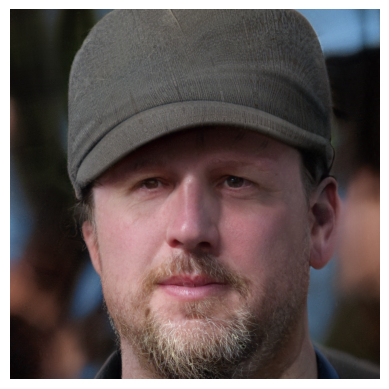

Direction 16


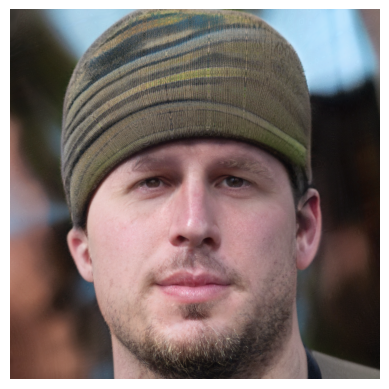

Direction 17


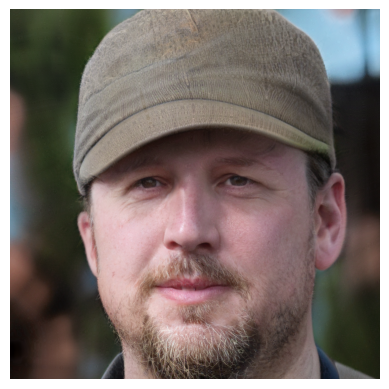

Direction 18


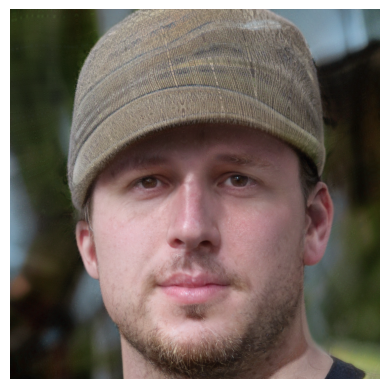

Direction 19


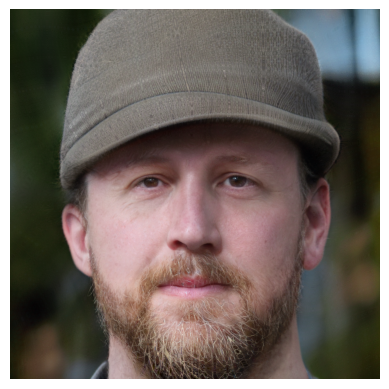

Direction 20


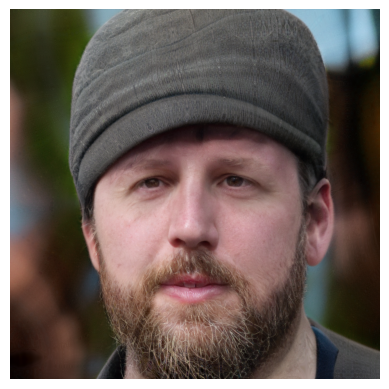

Direction 21


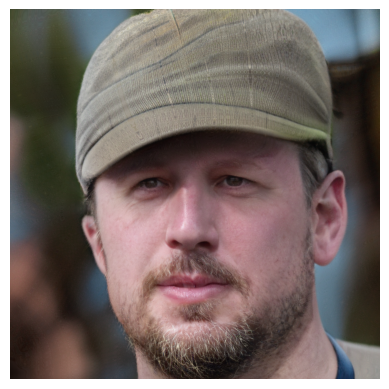

Direction 22


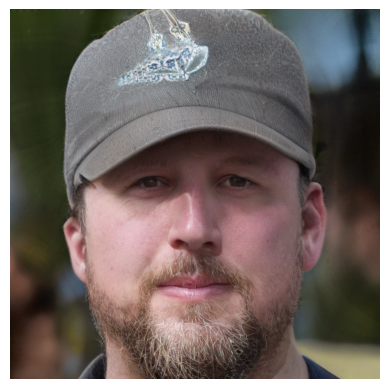

Direction 23


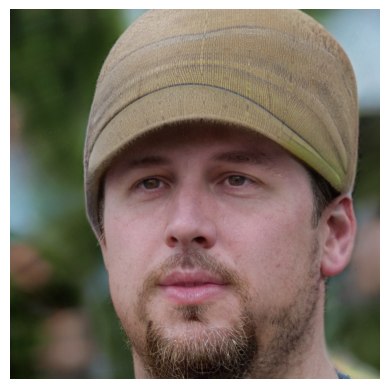

Direction 24


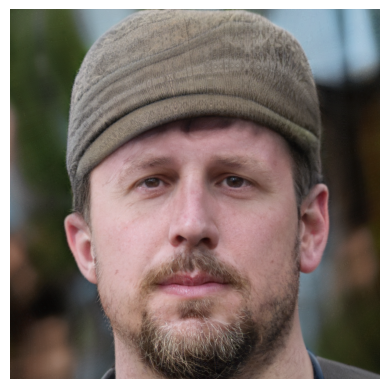

In [ ]:
np.random.seed(42)
MOVE_DIRECTION =20
SCALE = 0.5
folder_name = 'beard-transformation_images'
if MOVE_DIRECTION >=0:
  current = current + explore[MOVE_DIRECTION]

for i, mv in enumerate(explore):
  print(f"Direction {i}")
  z = current + mv
  img = generate_image(device, G, z)
  display_image(img)
  img.save(f'{folder_name}/image_{i}.jpg')
  img.save(f'/content/drive/MyDrive/beard-transformation_images/image_{i}.jpg')

Direction 0


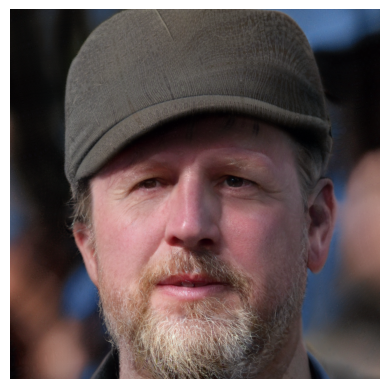

Direction 1


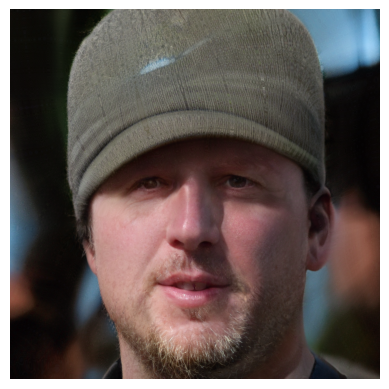

Direction 2


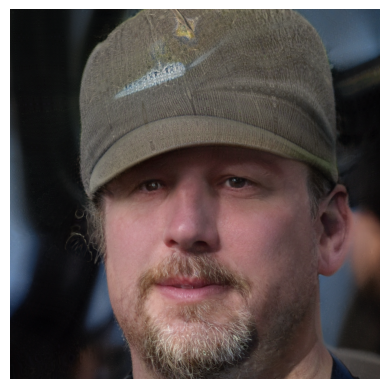

Direction 3


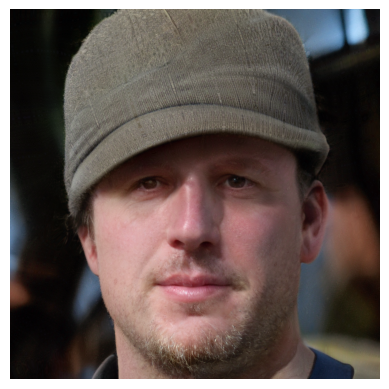

Direction 4


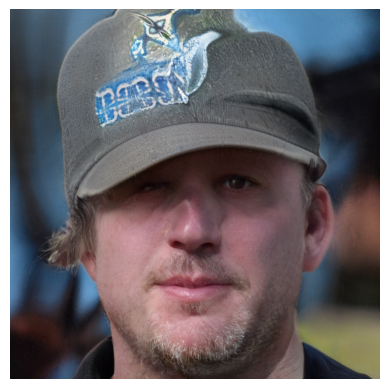

Direction 5


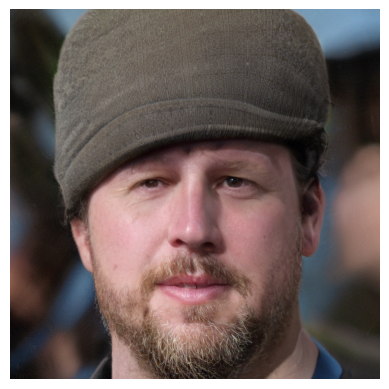

Direction 6


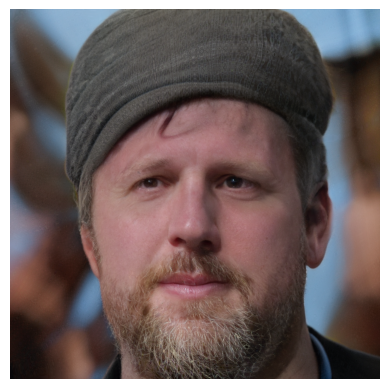

Direction 7


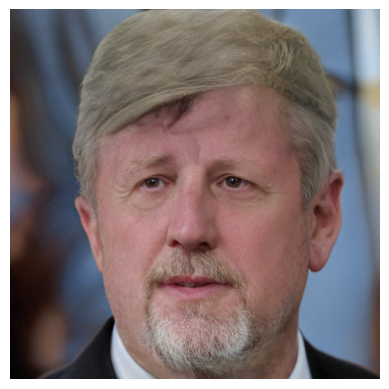

Direction 8


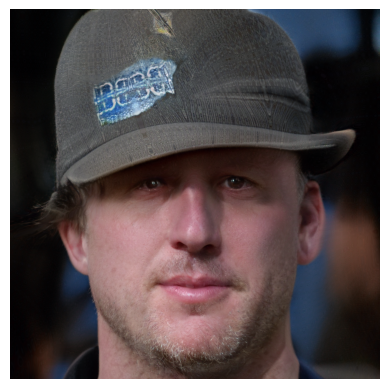

Direction 9


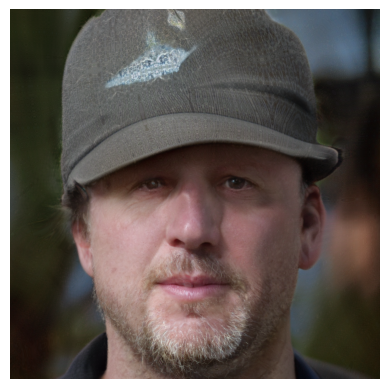

Direction 10


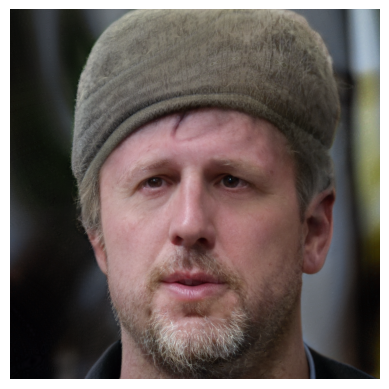

Direction 11


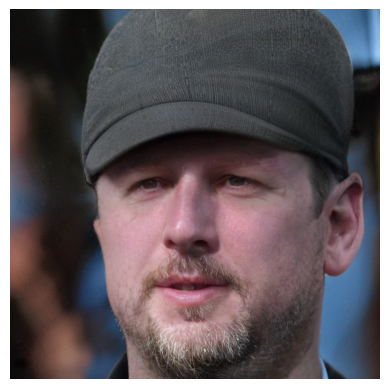

Direction 12


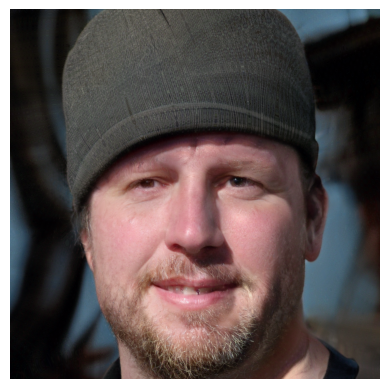

Direction 13


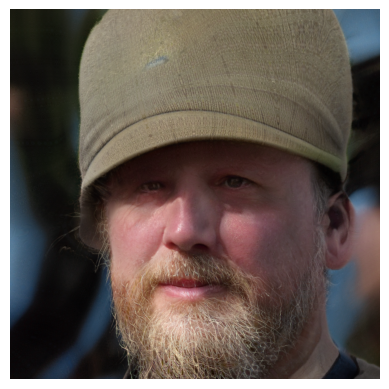

Direction 14


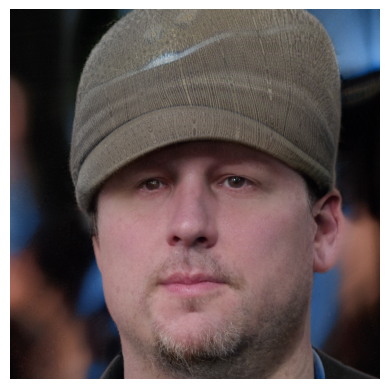

Direction 15


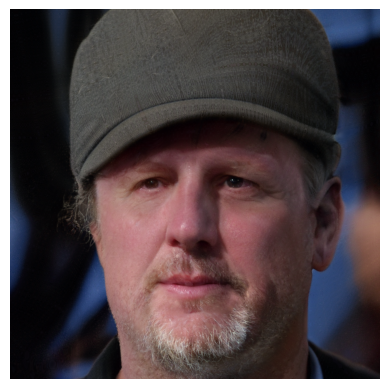

Direction 16


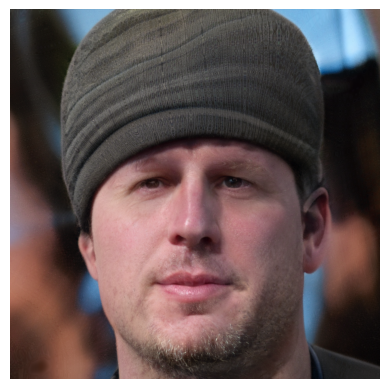

Direction 17


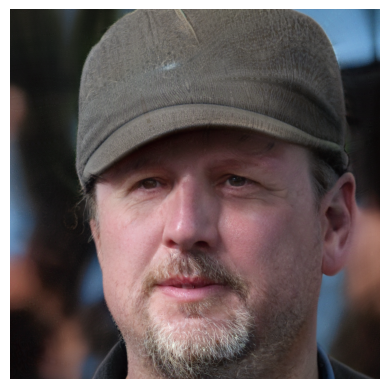

Direction 18


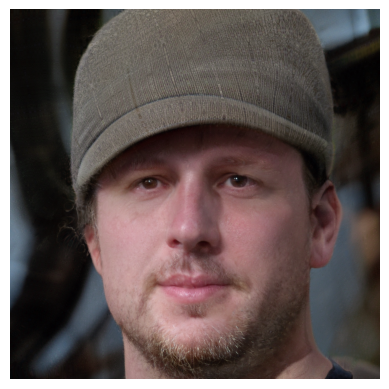

Direction 19


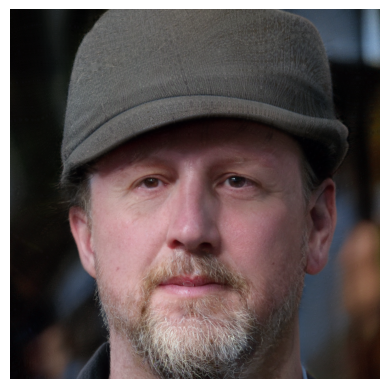

Direction 20


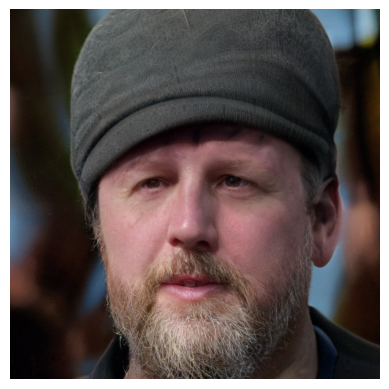

Direction 21


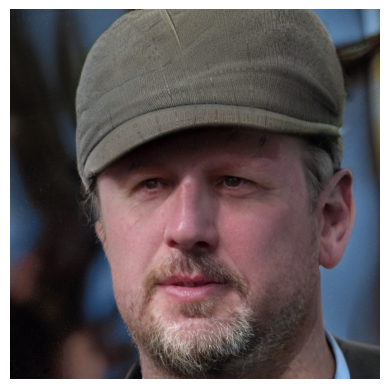

Direction 22


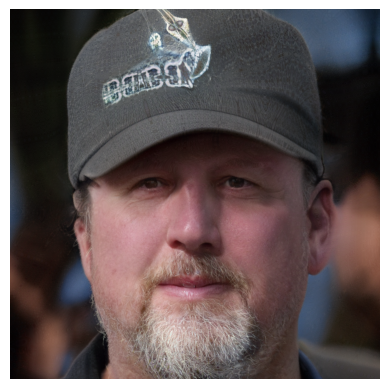

Direction 23


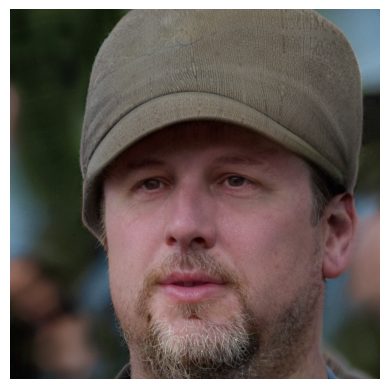

Direction 24


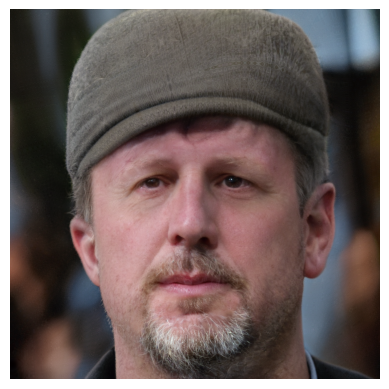

In [ ]:
MOVE_DIRECTION = 15
SCALE = 0.5
folder_name = 'age-transformation_images'
if MOVE_DIRECTION >=0:
  current = current + explore[MOVE_DIRECTION]

for i, mv in enumerate(explore):
  print(f"Direction {i}")
  z = current + mv
  img = generate_image(device, G, z)
  display_image(img)
  img.save(f'{folder_name}/image_{i}.jpg')
  img.save(f'/content/drive/MyDrive/age-transformation_images/image_{i}.jpg')